## Save a Copy (File -> Save a copy in Drive) to run

# Finding yourself in the latent space of StyleGAN

Dmitry Nikitko (puzer) wrote [the original code](https://github.com/Puzer/stylegan) for this notebook which extends the work released by NVidia on StyleGAN.

I then found [this one, which was edited to work better with Google Colabs](https://colab.research.google.com/drive/139OhnW0O_3-4IrnUCXRkO9nJn38qcdsi)

I added some features, such as editing the code to output intermediate images.
 
 After running through this notebook you should have a StyleGAN generated image (or set of images) which closely match photos of you that you've uploaded.

You'll also have a `npy` file which is the latent code (or location) of your image in the StyleGAN latent space.

In [2]:
# first, we clone my edited repo, which is based on 
# Puzer's stylegan-encoder repo, at https://github.com/Puzer/stylegan-encoder

#!git clone https://github.com/Puzer/stylegan-encoder # original code.
!git clone https://github.com/cdleong/stylegan-encoder.git stylegan

Cloning into 'stylegan'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 108 (delta 0), reused 1 (delta 0), pack-reused 105
Receiving objects: 100% (108/108), 10.24 MiB | 5.52 MiB/s, done.
Resolving deltas: 100% (35/35), done.


In [3]:
%cd stylegan
# Use the version this notebook was built with
#!git checkout c3fb250c65840c8837ded78e34485227755c2473

/content/stylegan


In [0]:
!mkdir raw_images aligned_images generated_images latent_representations not_pngs

## Add your image(s)

Upload your image using the Sidebar now. 

To open the sidebar select "View" and then "Table of Contents".

The sidebar should now be open. Click the "Files" tab.

Before uploading make sure:

1.   The image(s) you're using can be opened by PIL (jpg, png, etc)
2.   The images are larger than 1024x1024. Preferably significantly larger so the aligner can crop out a high resolution section of the image containing your face.
3.   Your face in the image is well lit and facing the camera (for best results)

Click ''Upload" in the sidebar and select the images you want to upload from your computer.

Note: All files uploaded in this manner end up in the root of the file tree. We'll move them into the correct spot next.

**Colin's Note:** Actually, it turns out you can right-click the "raw_images" folder and upload directly. You should be able to expand the file menu and find the folder.

In [0]:
# if you uploaded to the root folder, you may need to move the files.
# e.g. mv ../me.jpg raw_images/


## Convert images to PNG format

**Colin's Note:** The original notebook assumed you were using jpegs. However, I get much better results with PNG files for some reason.

Thus, we install the necessary conversion software, and transform our images


In [5]:
# First, we install Used for converting jpegs to png. 
# ImageMagick is good enough for jpgs, but we need ufraw for CR2
!sudo apt update && sudo apt install -y -qq imagemagick ufraw

Get:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran35/ InRelease [3,609 B]
Ign:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Ign:3 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Get:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release [564 B]
Get:5 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release [564 B]
Get:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release.gpg [819 B]
Get:7 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release.gpg [801 B]
Get:8 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Packages [54.8 kB]
Get:9 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Packages [5,867 B]
Hit:10 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease
Get

In [6]:
# CONVERT ALL JPEGs and CR2 to PNG, and back them up.
# tried using python, but bash ended up being easier.
# Command source: https://superuser.com/questions/71028/batch-converting-png-to-jpg-in-linux
%cd /content/stylegan/raw_images/

!for i in *.jpg ; do convert "$i" "${i%.*}.png" ; done
!for i in *.JPG ; do convert "$i" "${i%.*}.png" ; done
!for i in *.jpeg ; do convert "$i" "${i%.*}.png" ; done
!ufraw-batch --out-type png *.CR2

# if it is NOT a png, move it to the "not-png folder"
!find /content/stylegan/raw_images/ -type f ! -name "*.png" | xargs mv -t /content/stylegan/not_pngs/
% cd /content/stylegan/

/content/stylegan/raw_images
convert-im6.q16: unable to open image `*.jpg': No such file or directory @ error/blob.c/OpenBlob/2701.
convert-im6.q16: no images defined `*.png' @ error/convert.c/ConvertImageCommand/3258.
convert-im6.q16: unable to open image `*.JPG': No such file or directory @ error/blob.c/OpenBlob/2701.
convert-im6.q16: no images defined `*.png' @ error/convert.c/ConvertImageCommand/3258.
convert-im6.q16: unable to open image `*.jpeg': No such file or directory @ error/blob.c/OpenBlob/2701.
convert-im6.q16: no images defined `*.png' @ error/convert.c/ConvertImageCommand/3258.
ufraw-batch: Cannot open file *.CR2: No such file or directory
mv: missing file operand
Try 'mv --help' for more information.
/content/stylegan


## Align your images

**Colin's note**: Basically, crops out the "face" part of the image. 
If you've got a decent "face only" square picture (perhaps from a previous run?), you can put it in /content/stylegan/aligned_images/ directly.

In [12]:
# for some reason, Colabs generates checkpoints in the raw_images folder. 
# align_images.py chokes on them.
!rm -r /content/stylegan/raw_images/.ipynb*

# downloads data from http://dlib.net/files/shape_predictor_68_face_landmarks.dat.bz2, 
# then attempts to crop out the face in the picture.
!python align_images.py /content/stylegan/raw_images/ /content/stylegan/aligned_images/

Using TensorFlow backend.


This should produce an image in `aligned_images/` for every image in `raw_images/`.

It's a good idea to check that this process worked by using the Files browser to download each aligned image and make sure it looks reasonable. If you encounter scrambled images it might be because your original raw images are too small.

## Search for your latent self

The script `encode_images.py` will minimize the perceptual loss between generated images from StyleGAN and each of the images you've uploaded. (By default this happens one at a time)

I've had good results at 1000 iterations and it's best to check the general quality before coming back and ramping up the number of iterations to produce a high-quality latent.

Higher quality comes at a cost of course. 10000 iterations will take about **one hour** for one image.

**NOTE:** You may get a warning about the GPU memory limit when running this script. Don't worry it will still complete.

### **Colin's Notes**: 
I found out a few "gotchas" while running this. 

**"Quota Exceeded"**

During the encoding process, the program attempts to use a pretrained model in the "cache" folder. 

If it cannot find it, it will try to download a pretrained model from 'https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ', specifically, 'karras2019stylegan-ffhq-1024x1024.pkl'.

Sometimes, this download will fail, with a "Google Drive Quota Exceeded error." In such a case, all you can do is wait 24 hours or so.

...or, if you happen to have a copy of karras2019stylegan-ffhq-1024x1024.pkl, you can put it in the cache folder, and rename it. The program should like that.

**Too Much Output Causes Notebook to Hang**

If you set the number of iterations to a very high value, say 30,000, 
then you'll have a LOT of out put in the cell, and that can cause problems. "%%capture " fixes that

In [9]:
# This is how I calculated the hash to prepend to the pkl name.
#!mkdir cache
def demonstrate_hashing(url = None):
  import hashlib

  # got these urls from nvidia code. -Colin
  URL_FFHQ = 'https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ'  # karras2019stylegan-ffhq-1024x1024.pkl
  url_ffhq        = 'https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ' # karras2019stylegan-ffhq-1024x1024.pkl
  url_celebahq    = 'https://drive.google.com/uc?id=1MGqJl28pN4t7SAtSrPdSRJSQJqahkzUf' # karras2019stylegan-celebahq-1024x1024.pkl
  url_bedrooms    = 'https://drive.google.com/uc?id=1MOSKeGF0FJcivpBI7s63V9YHloUTORiF' # karras2019stylegan-bedrooms-256x256.pkl
  url_cars        = 'https://drive.google.com/uc?id=1MJ6iCfNtMIRicihwRorsM3b7mmtmK9c3' # karras2019stylegan-cars-512x384.pkl
  url_cats        = 'https://drive.google.com/uc?id=1MQywl0FNt6lHu8E_EUqnRbviagS7fbiJ' # karras2019stylegan-cats-256x256.pkl
  
  if not url:
    url=URL_FFHQ
  
  url_md5 = hashlib.md5(url.encode("utf-8")).hexdigest()
  print(f"Expected hash for {url} is {url_md5}, so we must prepend the .pkl file with this hash.")

demonstrate_hashing()

Expected hash for https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ is 263e666dc20e26dcbfa514733c1d1f81, so we must prepend the .pkl file with this hash.


In [16]:
you_want_to_load_pkl_from_your_google_drive = True

if you_want_to_load_pkl_from_your_google_drive:
  
  #Google Drive setup
  from google.colab import drive
  drive.mount('/content/gdrive')
  
  # copy saved pkl file from Google Drive, so that it doesn't hit the URL_FFHQ link
  # which often gives "drive quota exceeded" errors
  import os
  import shutil 
  
  # path to the folder in your Gdrive containing 
  # karras2019stylegan-ffhq-1024x1024.pkl
  pkl_folder="/content/gdrive/My Drive/Colab Notebooks/data/stylegan"
  print(os.listdir(pkl_folder))

  # setup the cache folder, copy the pkl file.
  !mkdir cache
  !ls -al /content/gdrive/My\ Drive/Colab\ Notebooks/data/stylegan/
  !cp -v /content/gdrive/My\ Drive/Colab\ Notebooks/data/stylegan/karras2019stylegan-ffhq-1024x1024.pkl /content/stylegan/cache/
  print(os.listdir("cache"))
  
  # StyleGan code expects it to be named "263e666dc20e26dcbfa514733c1d1f81_*
  # which is an md5 hash of the URL, plus some filename. 
  # We edit the name to match this expectation
  !mv cache/karras2019stylegan-ffhq-1024x1024.pkl cache/263e666dc20e26dcbfa514733c1d1f81_karras2019stylegan-ffhq-1024x1024.pkl
  
else:
  print("Not loading from Google Drive, then. If you get a 'Drive Quota Exceeded' error, come back and edit/rerun this cell.")

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive
['karras2019stylegan-celebahq-1024x1024.pkl', 'karras2019stylegan-ffhq-1024x1024.pkl']
total 634245
-rw------- 1 root root 324733199 Feb 23 06:59 karras2019stylegan-celebahq-1024x1024.pkl
-rw------- 1 root root 324733157 Feb 23 07:29 karras2019stylegan-ffhq-1024x1024.pkl
'/content/gdrive/My Drive/Colab Notebooks/data/stylegan/karras2019stylegan-ffhq-1024x1024.pkl' -> '/content/stylegan/cache/karras2019stylegan-ffhq-1024x1024.pkl'
['karras2019stylegan-ffhq-102

**Now we actually run the encoder**

**Colin's Note**: Apparently, it picks a random point in the "latent" (input to GAN) space, and generates a picture. Then, it calculates a similarity score using the [Fréchet Inception Distance](https://nealjean.com/ml/frechet-inception-distance/), and then it does simple gradient descent. No momentum or anything, just straight Gradien Descent. For more info, check the encoder source code.

My customizations cause it to output intermediate results. You can download the generated images to check on progress. 

You can also parse the "out.txt" file to generate a loss curve.



In [0]:

# The following line prevents output. Colabs hates it when you have, say, 100000 lines of output.
%%capture

#original code
#!python encode_images.py aligned_images/ generated_images/ latent_representations/ --iterations 4000

# sometimes Colabs adds this folder, then the encoder chokes on it.
!rm -r cache/.ipynb_checkpoints/

# My custom version outputs intermediate results. Check the generated_images
# and latent_representations_folders
!python encode_images.py aligned_images/ generated_images/ latent_representations/ --iterations 160000 2>&1|tee "`date +%s`_out.txt"

## Download Your Results

After the above cell has finished writing there should be an image in `generated_images/` for each image in `aligned_images/`.

You can right-click and download each of these images to see your final latent self.

### Latent Representation

You can also download the `npy` files in the `latent_representations/` directory. Each of those is a serialized numpy array which contains the (18, 512) array encoding the point in latent space which corresponds to the generated image. Which you can open with `latent = np.load('filename.npy')`

In [0]:
!ls -al /content/stylegan/generated_images/
!ls -al /content/stylegan/latent_representations/

### Change your Smile, Gender, or Age

Once your latent representation has been generated and saved you can explore the volume around it through latent vectors. Puzer has provided vectors for Smile, Gender and Age so you can see what you look like as your latent self varies along those axes.

Run the following cells.

In [0]:
import os
import pickle
import PIL.Image
import numpy as np
import dnnlib
import dnnlib.tflib as tflib
import config
from encoder.generator_model import Generator

import matplotlib.pyplot as plt
%matplotlib inline

In [19]:
URL_FFHQ = 'https://drive.google.com/uc?id=1MEGjdvVpUsu1jB4zrXZN7Y4kBBOzizDQ'

tflib.init_tf()
with dnnlib.util.open_url(URL_FFHQ, cache_dir=config.cache_dir) as f:
    generator_network, discriminator_network, Gs_network = pickle.load(f)

generator = Generator(Gs_network, batch_size=1, randomize_noise=False)

Instructions for updating:
Colocations handled automatically by placer.


In [0]:
def generate_image(latent_vector):
    latent_vector = latent_vector.reshape((1, 18, 512))
    generator.set_dlatents(latent_vector)
    img_array = generator.generate_images()[0]
    img = PIL.Image.fromarray(img_array, 'RGB')
    return img.resize((1024, 1024))

def move_and_show(latent_vector, direction, coeffs):
    fig,ax = plt.subplots(1, len(coeffs), figsize=(15, 10), dpi=80)
    for i, coeff in enumerate(coeffs):
        new_latent_vector = latent_vector.copy()
        new_latent_vector[:8] = (latent_vector + coeff*direction)[:8]
        ax[i].imshow(generate_image(new_latent_vector))
        ax[i].set_title('Coeff: %0.1f' % coeff)
    [x.axis('off') for x in ax]
    plt.show()
    
def show_and_save_image(latent_vector, direction, coeff, outputname=None, title=False):
  plt.figure()
  new_latent_vector = latent_vector.copy()
  new_latent_vector[:8] = (latent_vector + coeff*direction)[:8]
  img = generate_image(new_latent_vector)
  if outputname:
    img.save(outputname)
  plt.imshow(img)
  if title:
    plt.set_title('Coeff: %0.1f' % coeff)  
  plt.axis("off")
  plt.show()
  return new_latent_vector


In [0]:
# Loading already learned representations
# me = np.load('latent_representations/00012000_iterations__MG_4140_01.npy') # glasses
# me = np.load('latent_representations/00013700_iterations__MG_4141_01.npy') # no glasses
me = np.load('latent_representations/00004500_iterations__MG_4138_01.npy') # no hat, no glasses



In [0]:
# Loading already learned latent directions
smile_direction = np.load('ffhq_dataset/latent_directions/smile.npy')
gender_direction = np.load('ffhq_dataset/latent_directions/gender.npy')
age_direction = np.load('ffhq_dataset/latent_directions/age.npy')

# In general it's possible to find directions of almost any face attributes: position, hair style or color ... 
# Additional scripts for doing so will be realised soon

In [0]:
!mkdir direction_fun

# Smile transformation

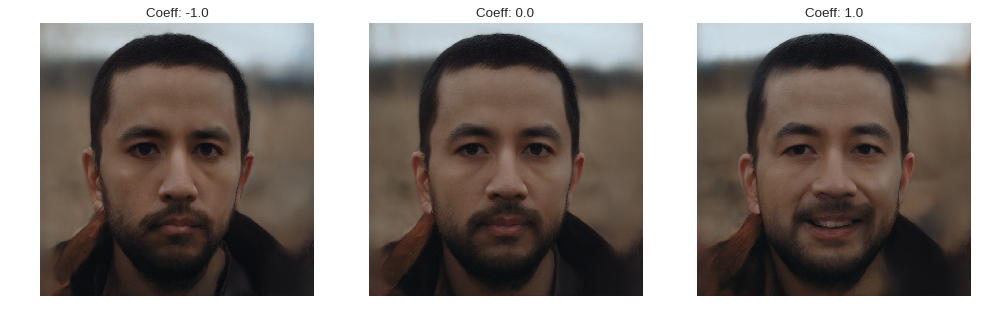

In [25]:
move_and_show(me, smile_direction, [-1, 0, 1])

# Gender transformation

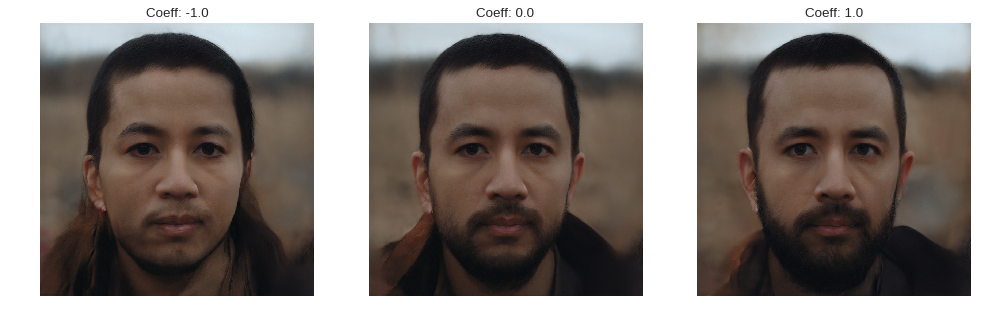

In [26]:
move_and_show(me, gender_direction, [-1, 0, 1])

# Age transformation

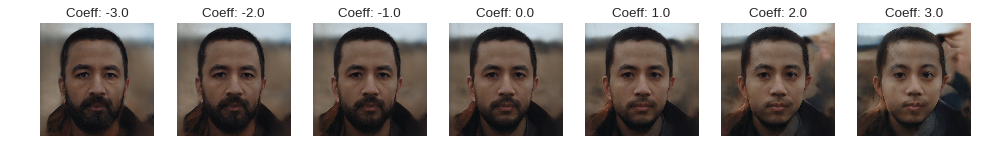

In [54]:
move_and_show(me, age_direction, [-3, -2, -1, 0, 1, 2, 3])

## We Must Go Deeper

![a man in a hat suggests trying more power](https://what-if.xkcd.com/imgs/a/13/laser_pointer_more_power.png)

(image from [XKCD "what-if" #13](https://))


In [0]:
def go_deeper(magnitude):
  print(f"less smile<---->more smile, magnitude = {magnitude}")
  move_and_show(me, smile_direction, [-magnitude, 0, magnitude])
  print(f"feminine---->male, magnitude = {magnitude}")
  move_and_show(me, gender_direction, [-magnitude, 0, magnitude])
  print(f"old<---->young, magnitude = {magnitude}")
  move_and_show(me, age_direction, [-magnitude, 0, magnitude])
  

less smile<---->more smile, magnitude = 2


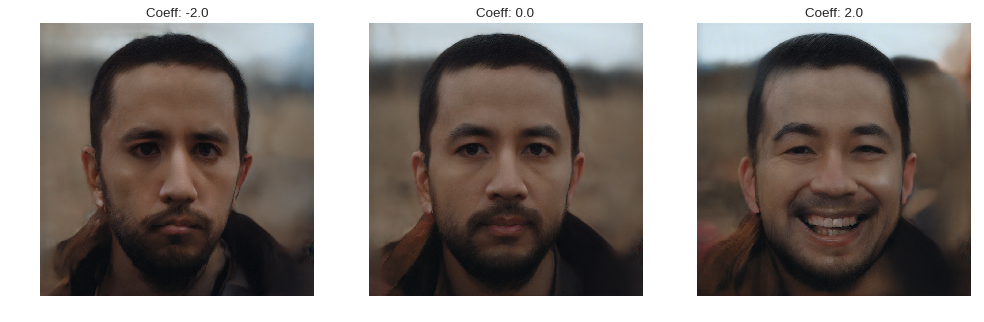

feminine---->male, magnitude = 2


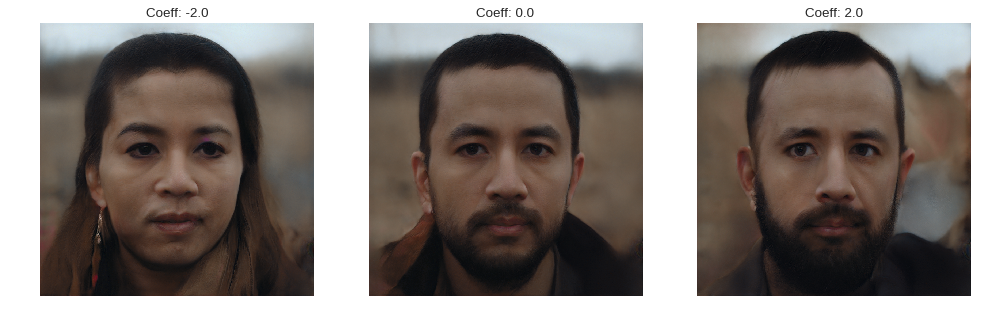

old<---->young, magnitude = 2


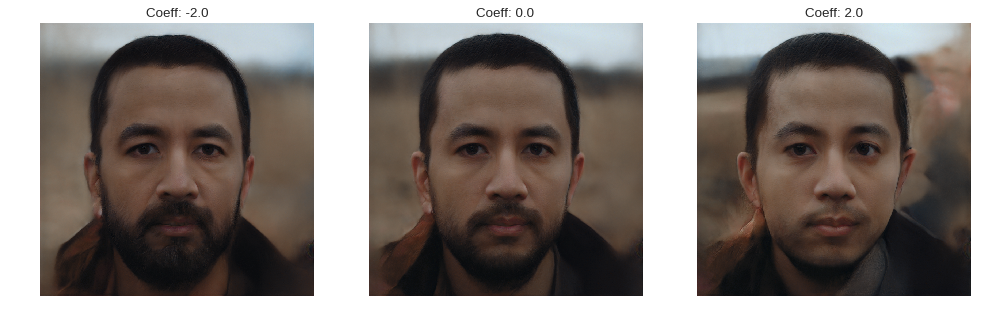

In [37]:
go_deeper(2)

## We Must Go Deeper

![a man in a hat suggests trying more power](https://what-if.xkcd.com/imgs/a/13/laser_pointer_more_power.png)

(image from [XKCD "what-if" #13](https://))


less smile<---->more smile, magnitude = 3


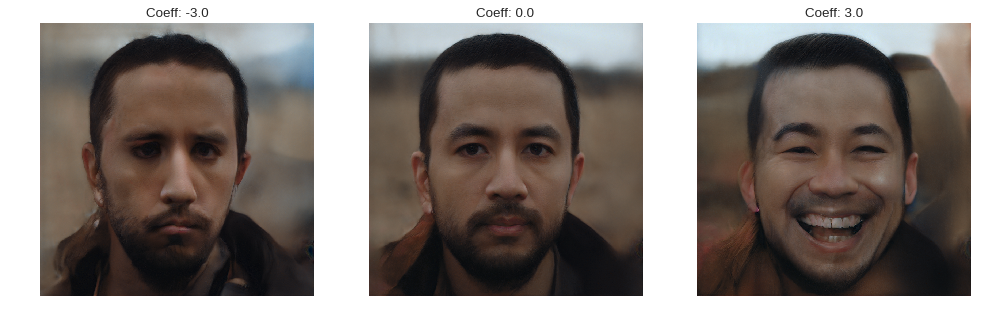

feminine---->male, magnitude = 3


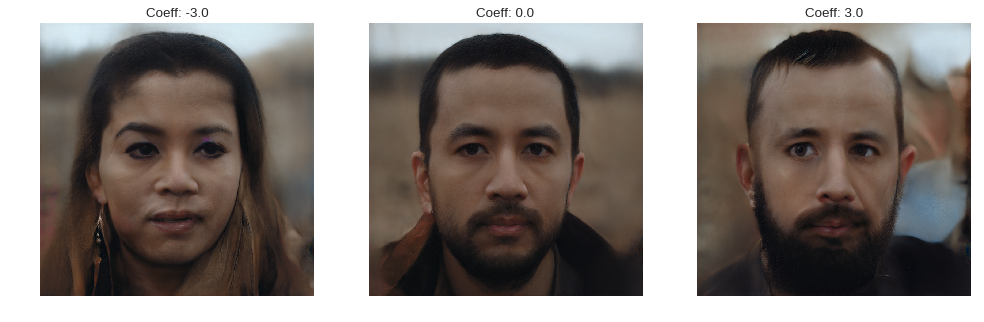

old<---->young, magnitude = 3


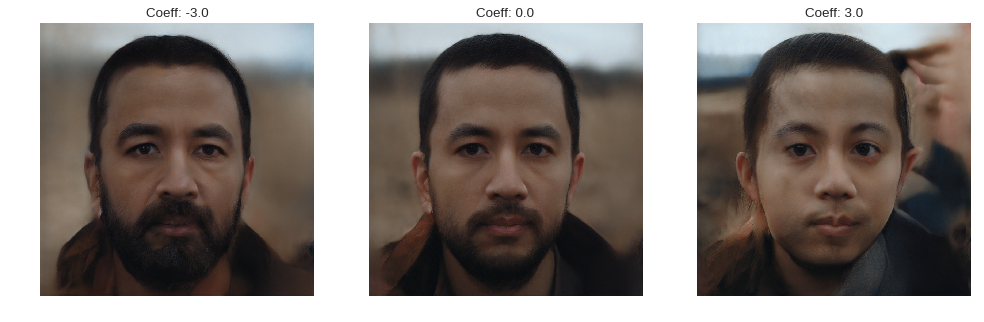

In [38]:
go_deeper(3)

## We Must Go Deeper

![a man in a hat suggests trying more power](https://what-if.xkcd.com/imgs/a/13/laser_pointer_more_power.png)

(image from [XKCD "what-if" #13](https://))


less smile<---->more smile, magnitude = 4


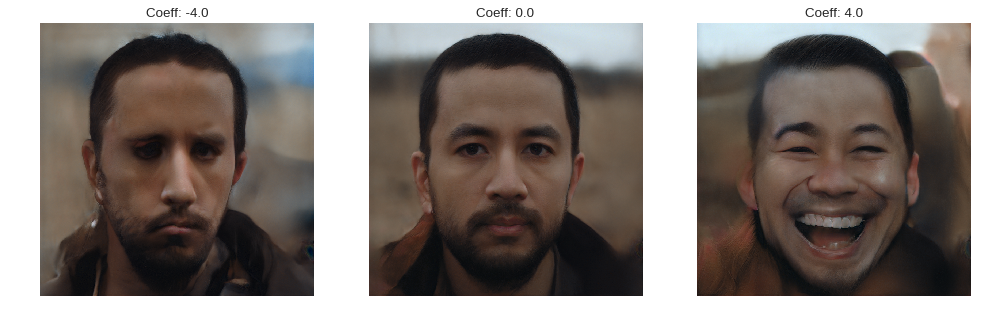

feminine---->male, magnitude = 4


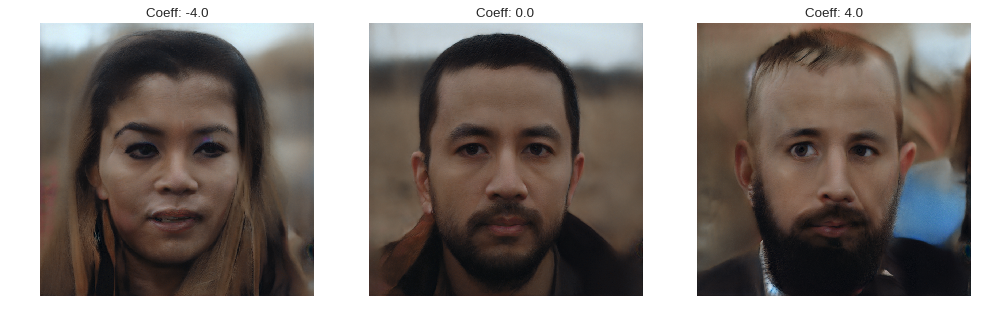

old<---->young, magnitude = 4


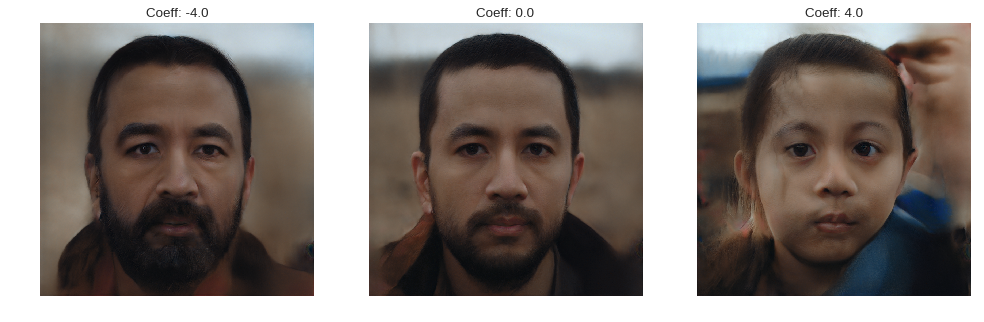

In [40]:
go_deeper(4)

## We Must Go Deeper

![a man in a hat suggests trying more power](https://what-if.xkcd.com/imgs/a/13/laser_pointer_more_power.png)

(image from [XKCD "what-if" #13](https://))


less smile<---->more smile, magnitude = 5


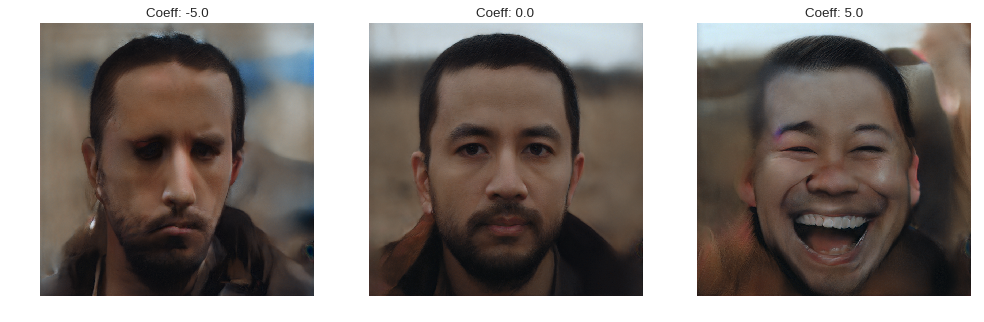

feminine---->male, magnitude = 5


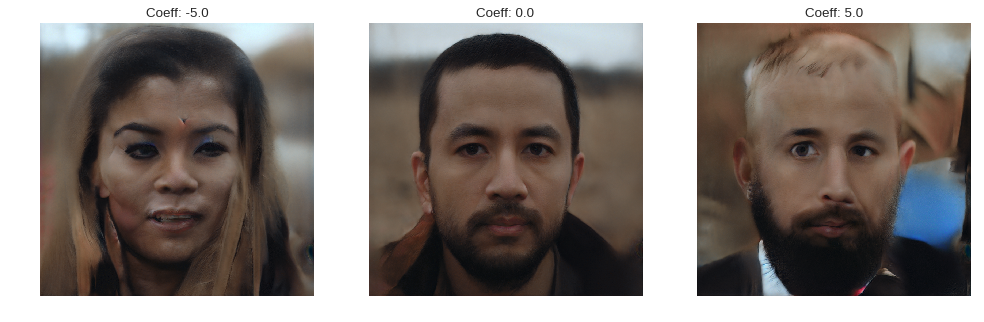

old<---->young, magnitude = 5


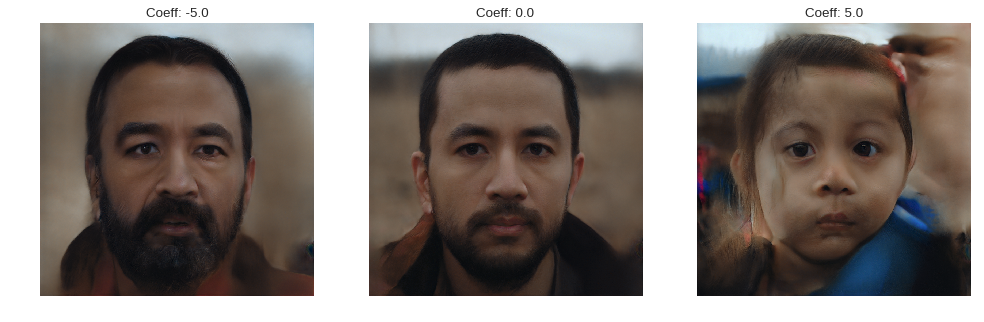

In [41]:
go_deeper(5)

## We Must Go Deeper

![a man in a hat suggests trying more power](https://what-if.xkcd.com/imgs/a/13/laser_pointer_more_power.png)

(image from [XKCD "what-if" #13](https://))


less smile<---->more smile, magnitude = 10


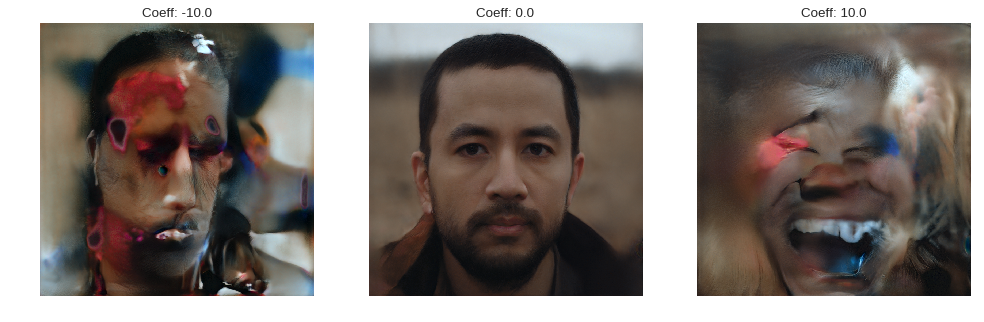

feminine---->male, magnitude = 10


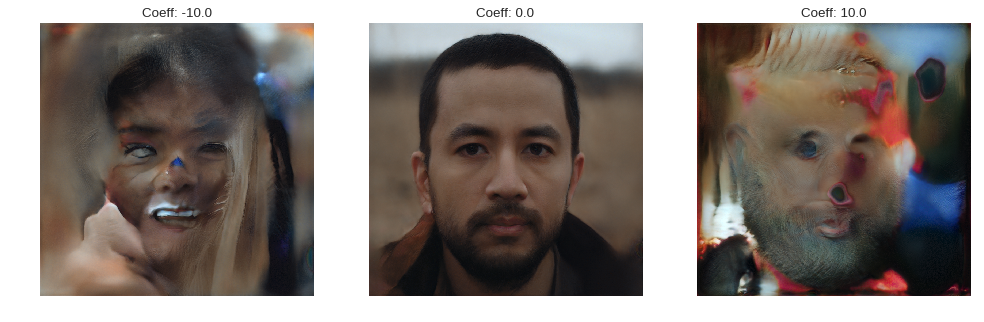

old<---->young, magnitude = 10


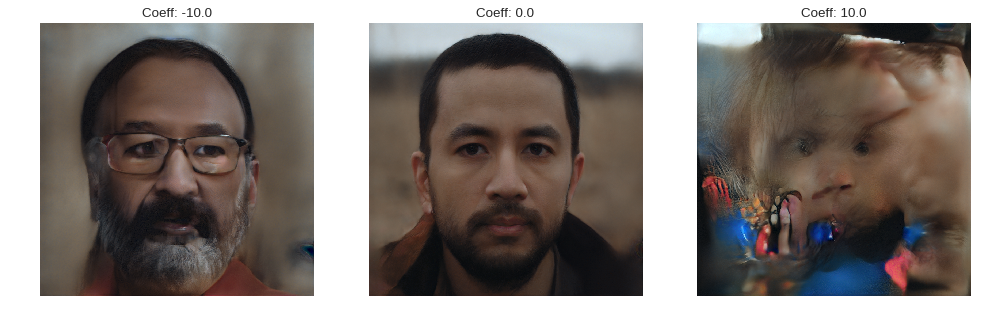

In [46]:
go_deeper(10)

## We Must Go Deeper

![a man in a hat suggests trying more power](https://what-if.xkcd.com/imgs/a/13/laser_pointer_more_power.png)

(image from [XKCD "what-if" #13](https://))


In [0]:
def go_even_deeper(direction, how_deep, left, right):
  for i in range(how_deep):
    magnitude = 2**i
    print(f"{left}<---->{right}")
    move_and_show(me, direction, [-magnitude, 0, magnitude])
    
  

less smile<---->more smile


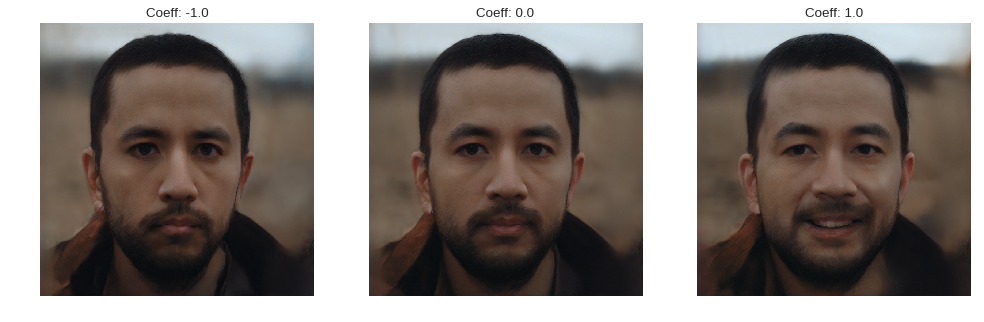

less smile<---->more smile


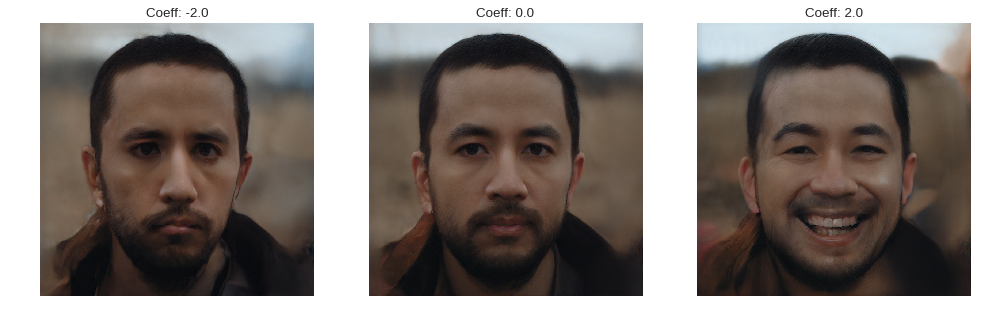

less smile<---->more smile


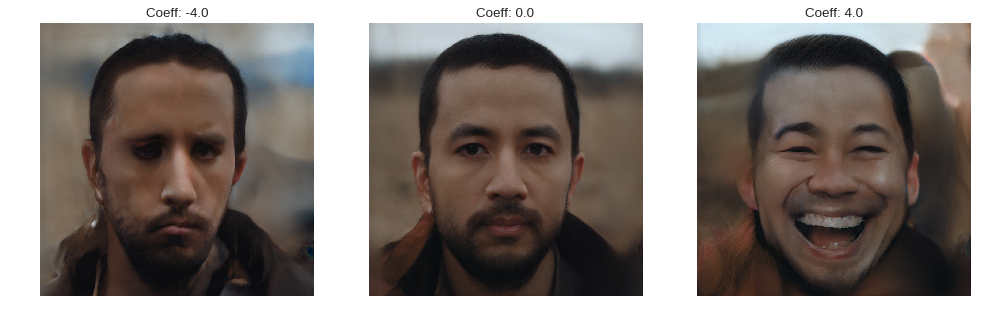

less smile<---->more smile


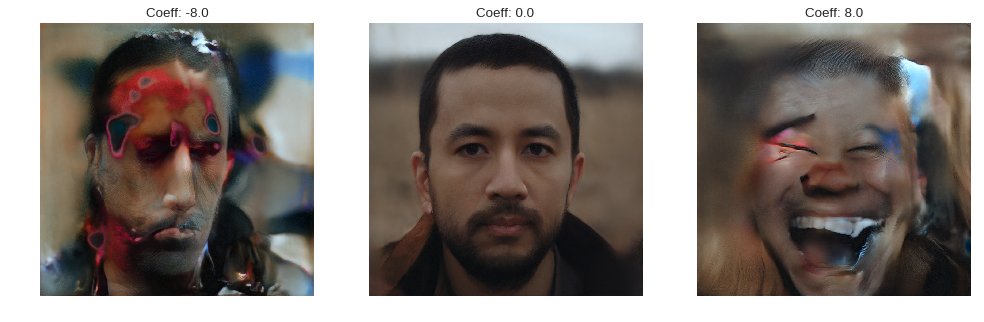

less smile<---->more smile


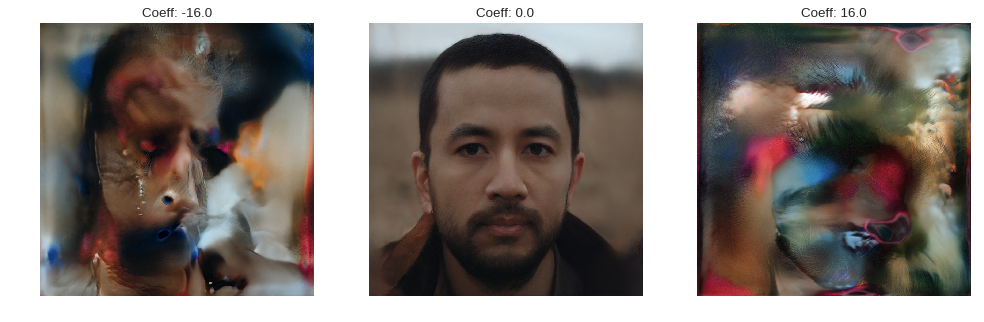

less smile<---->more smile


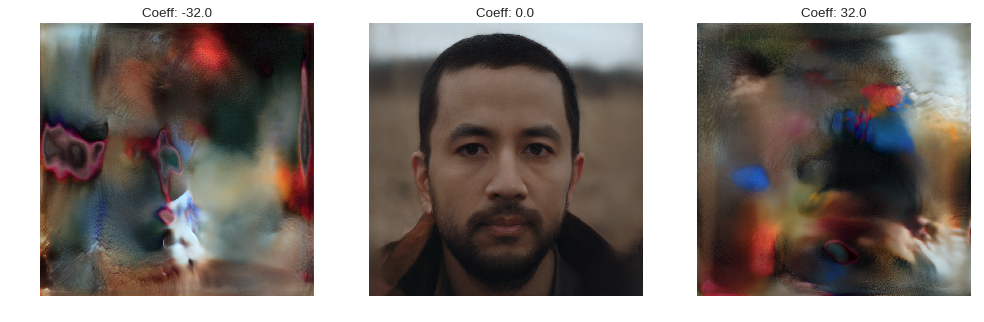

less smile<---->more smile


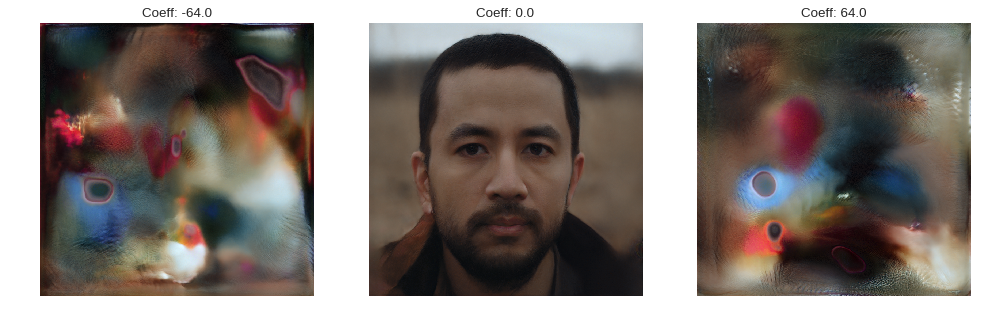

less smile<---->more smile


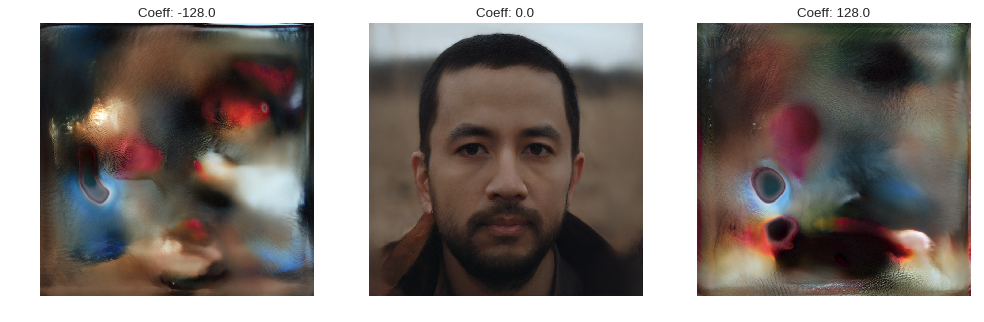

less smile<---->more smile


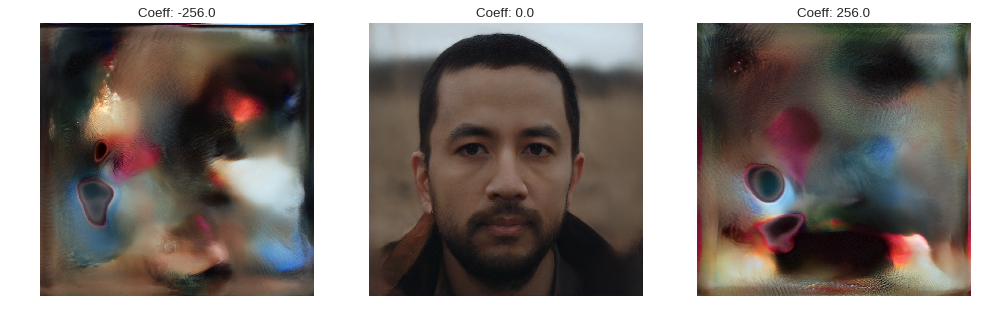

less smile<---->more smile


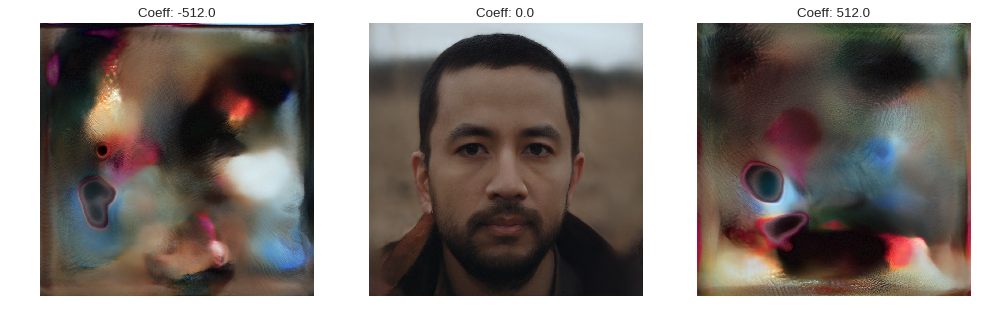

In [51]:
go_even_deeper(smile_direction, 10, "less smile", "more smile")

feminine<---->male


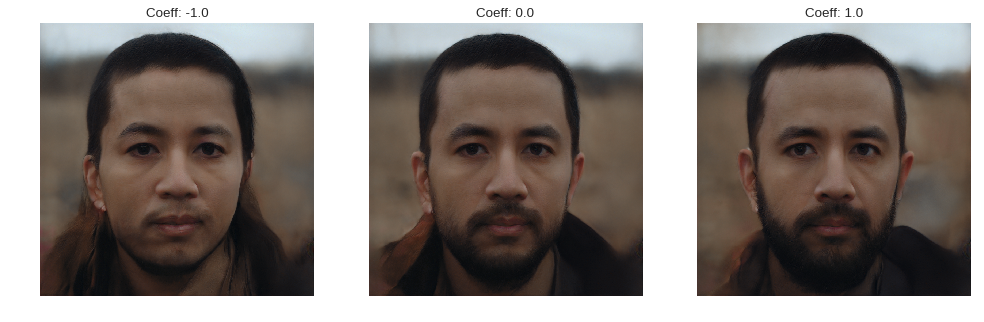

feminine<---->male


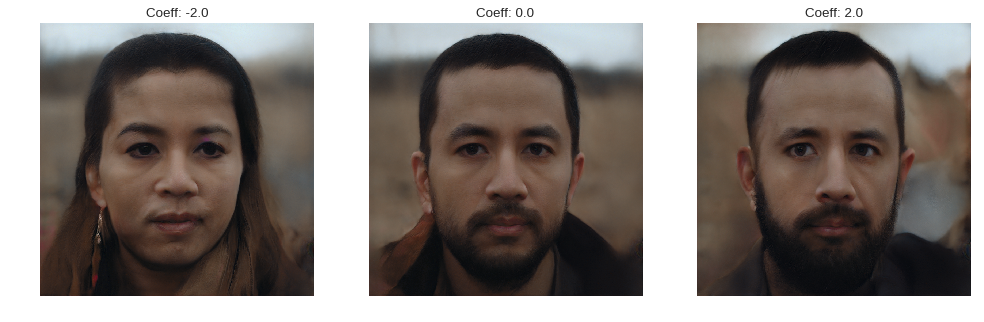

feminine<---->male


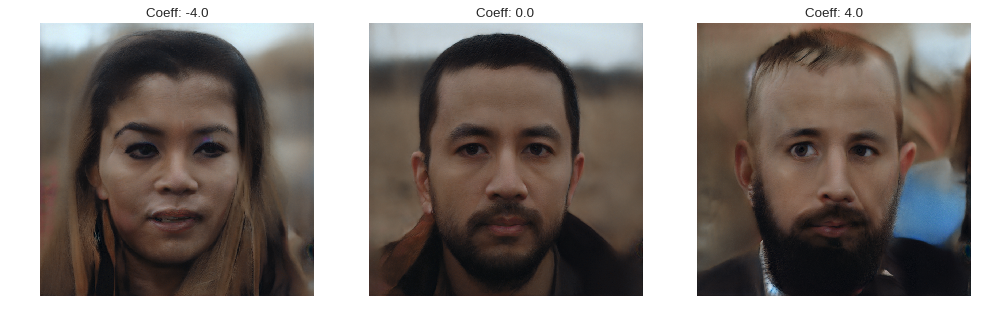

feminine<---->male


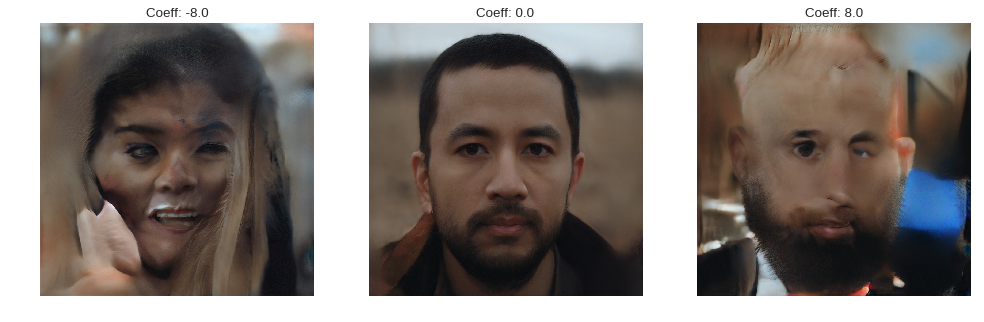

feminine<---->male


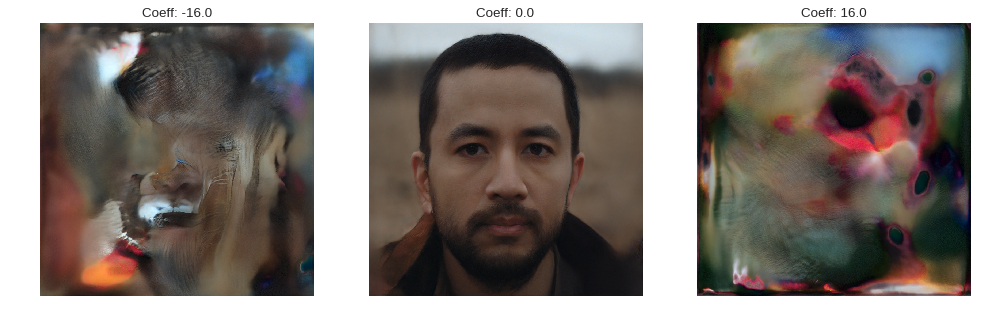

feminine<---->male


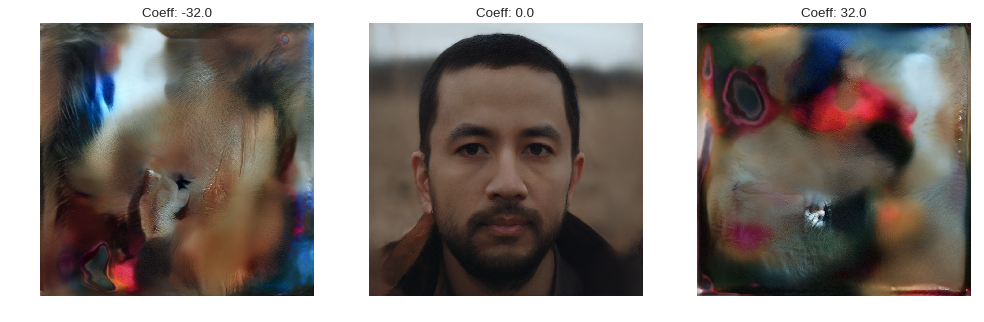

feminine<---->male


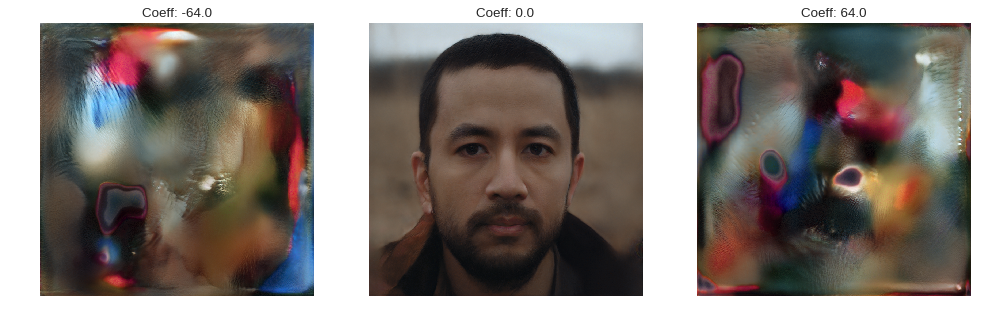

feminine<---->male


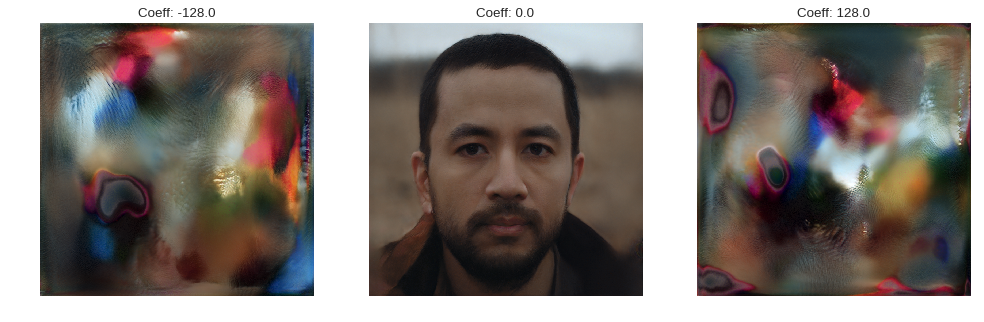

feminine<---->male


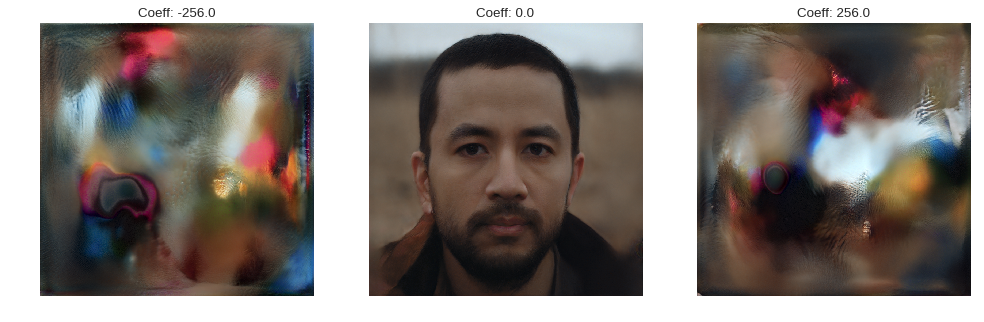

feminine<---->male


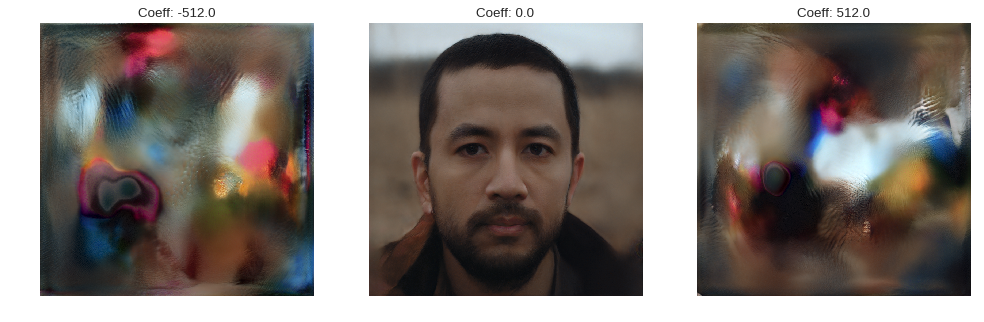

In [52]:
go_even_deeper(gender_direction, 10, "feminine", "male")

old<---->young


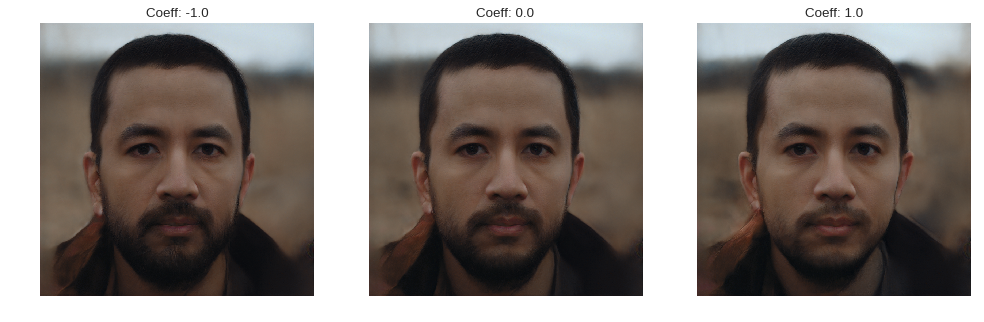

old<---->young


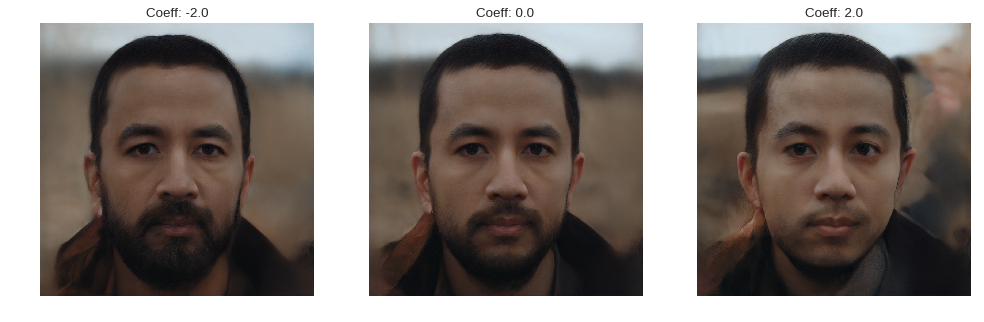

old<---->young


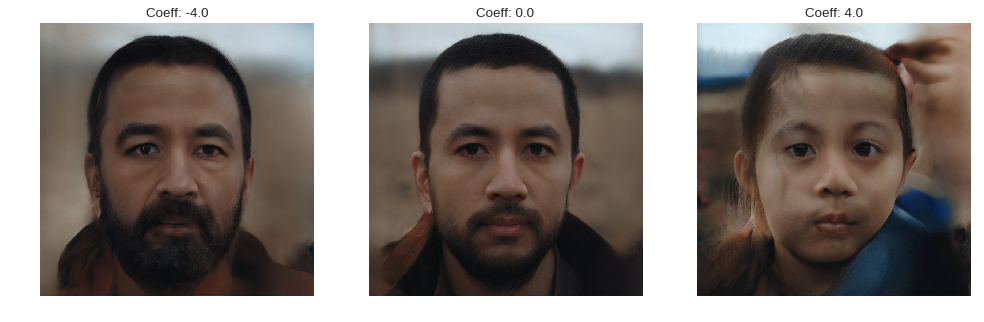

old<---->young


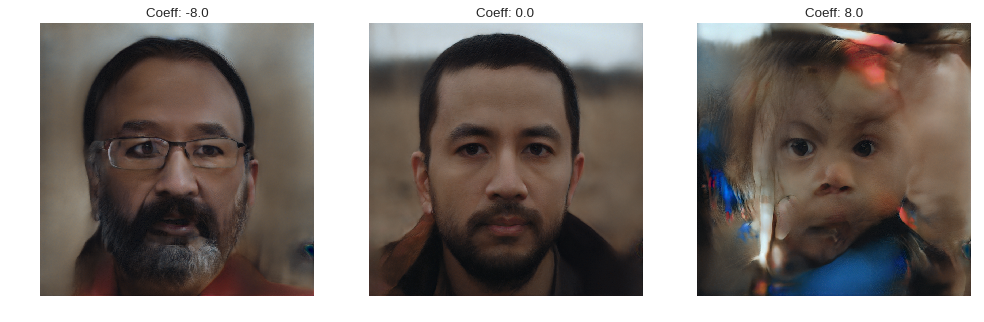

old<---->young


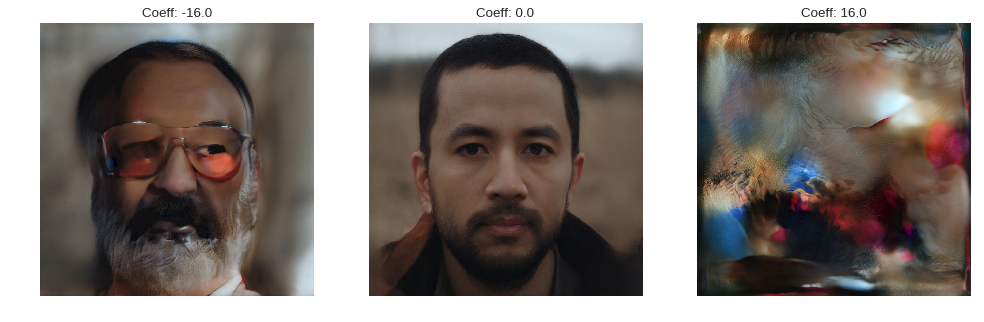

old<---->young


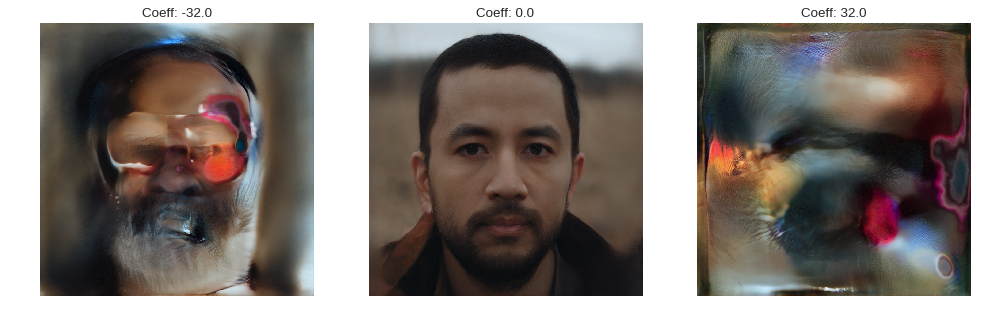

old<---->young


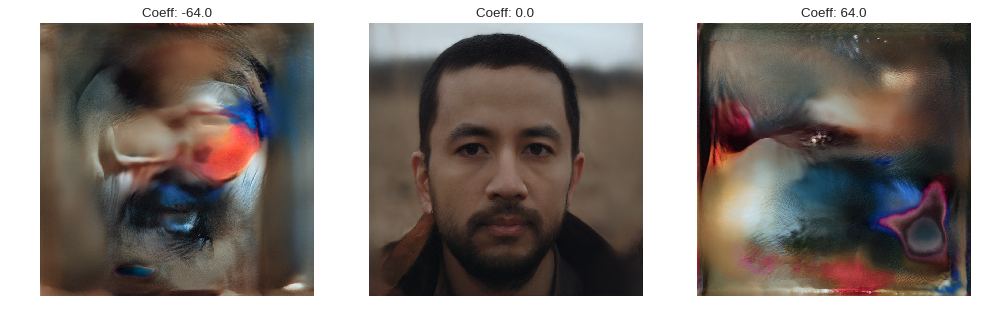

old<---->young


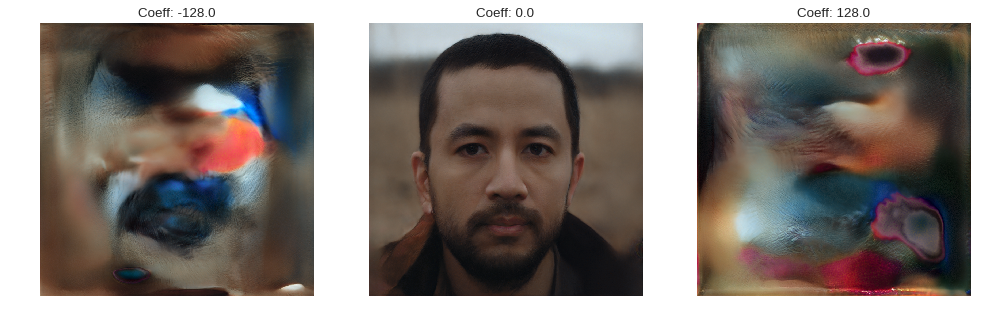

old<---->young


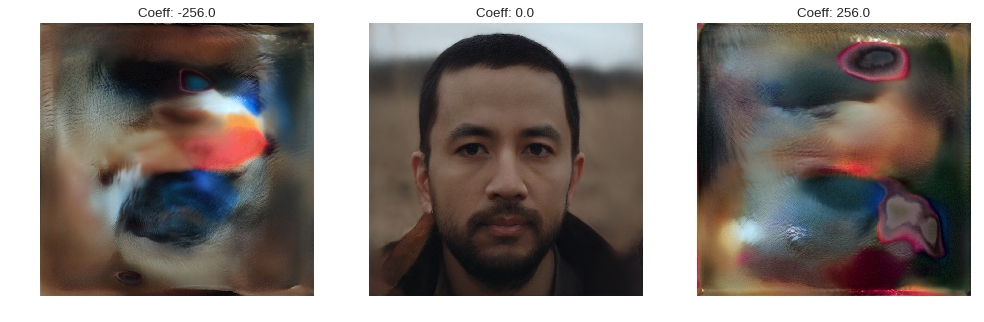

old<---->young


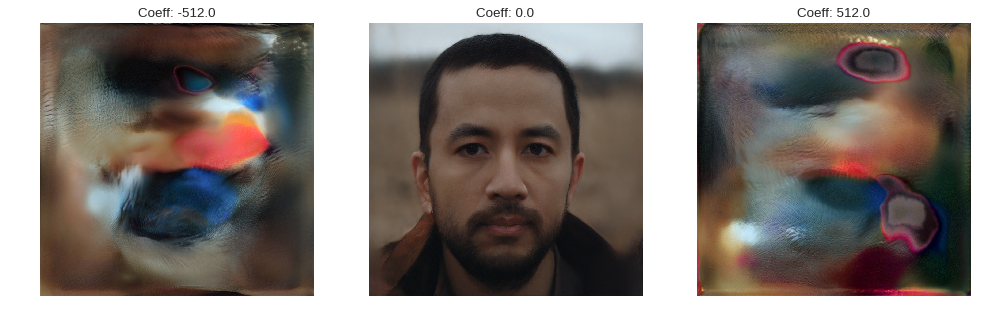

In [53]:
go_even_deeper(age_direction, 10, "old", "young")

In [0]:

for magnitude in np.arange(0, 2, 0.05):
  show_and_save_image(me, gender_direction, -magnitude, f"direction_fun/female_{magnitude}.png")
  
#for magnitude in np.arange(0, 4, 0.1):  
#  show_image(me, gender_direction, magnitude, f"direction_fun/boy_colin_4141_magnitude_{magnitude}.png")

In [0]:
for magnitude in range(30):
  show_and_save_image(me, age_direction, -magnitude, f"direction_fun/old_colin_4141_magnitude_{magnitude}.png")
  
for magnitude in range(30):  
  show_and_save_image(me, age_direction, magnitude, f"direction_fun/young_colin_4141_magnitude_{magnitude}.png")

## Can we form a closure? 


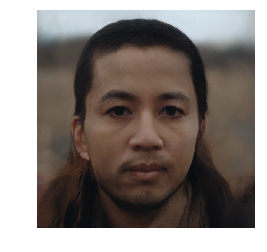

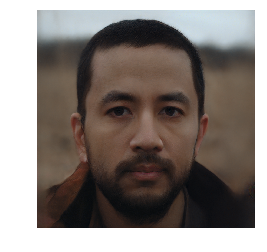

In [60]:
# start with magnitude zero, go in the girl direction (negative)
female_1 = show_and_save_image(me, gender_direction, -1, f"direction_fun/back_and_forth_gender_1.png")

# can we go back?
female_1_male_1 = show_and_save_image(female_1, gender_direction, 1, f"direction_fun/back_and_forth_gender_0.png")

In [0]:
def girl_old_closure(magnitude):
  # start with magnitude zero, go in the girl direction (negative)
  print(f"female_{magnitude}_old_0")
  female_1_old_0 = show_and_save_image(me, gender_direction, -magnitude, f"direction_fun/female_{magnitude}_age_0.png")

  # now go in the old direction (negative), 
  # but starting with the result of the last one.
  print(f"female_{magnitude}_old_{magnitude}")
  female_1_old_1 = show_and_save_image(female_1_old_0, age_direction, -magnitude, f"direction_fun/female_{magnitude}_old_{magnitude}.png")

  # now go in the -female direction
  print(f"female_0_old_{magnitude}")
  female_0_old_1 = show_and_save_image(female_1_old_1, gender_direction, magnitude, f"direction_fun/female_0_old_{magnitude}.png")

  # now back in the -old direction
  print(f"female_0_old_0")
  female_0_old_0 = show_and_save_image(female_0_old_1, age_direction, magnitude, f"direction_fun/female_0_old_0.png")

female_2_old_0


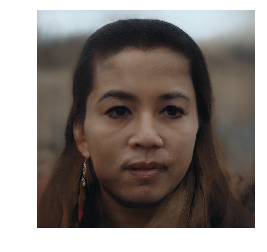

female_2_old_2


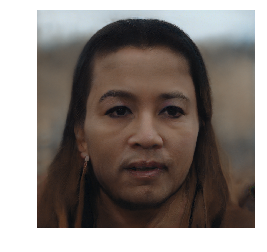

female_0_old_2


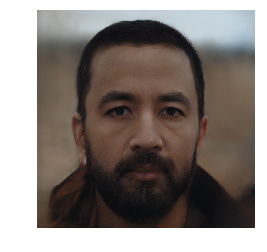

female_0_old_0


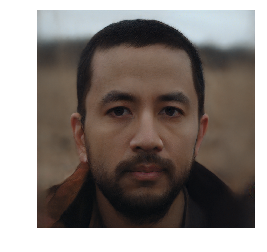

In [62]:
girl_old_closure(2)

female_4_old_0


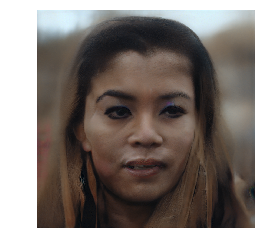

female_4_old_4


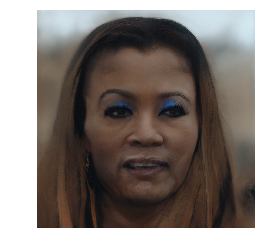

female_0_old_4


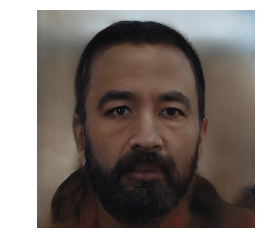

female_0_old_0


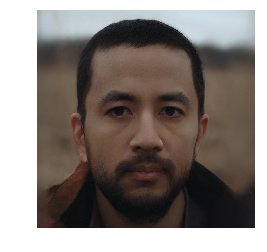

In [63]:
girl_old_closure(4)

female_10_old_0


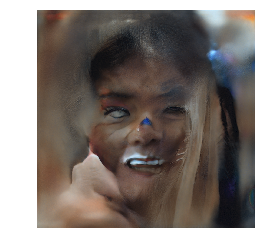

female_10_old_10


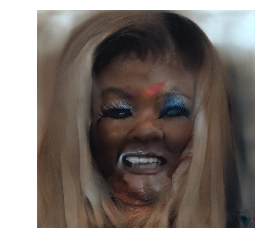

female_0_old_10


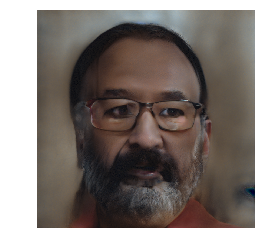

female_0_old_0


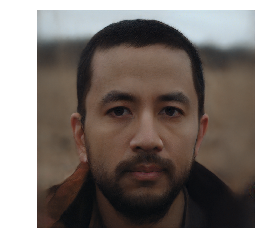

In [64]:
girl_old_closure(10)

... turns out, yes you can form a closure. Hmmm...



## Age + Gender Grid

Let's see if we can do this!

TODO: make a grid. 
* Age on one axis, gender on another axis.

## Wrapup
Now, we zip the files, for convenient downloading.

And we clean out various folders. 

Or, you could just "reset all runtimes". Up to you.

In [0]:
!zip -r direction_fun.zip direction_fun
!zip -r latent_representations.zip latent_representations
!zip -r generated_images.zip generated_images
!zip -r aligned_images.zip aligned_images

!mkdir results
!mv *_out.txt results
!mv *.zip results
!zip -r "`date +%s`_results.zip" results && rm -r results

In [0]:
# clean out results
!ls -alh /content/stylegan/aligned_images/
!ls -alh /content/stylegan/latent_representations/
!ls -alh /content/stylegan/generated_images/

!rm /content/stylegan/aligned_images/*
!rm /content/stylegan/latent_representations/*
!rm /content/stylegan/generated_images/*

!rm *.png
!rm direction_fun/*.png

!rm -r /content/stylegan/aligned_images/.ipy*
!rm -r /content/stylegan/latent_representations/.ipy*
!rm -r /content/stylegan/generated_images/.ipy*

!ls -alh /content/stylegan/aligned_images/
!ls -alh /content/stylegan/latent_representations/
!ls -alh /content/stylegan/generated_images/